### OSMNX isolines map

In this notebook we are going to create the following three types of maps:
- <u>Map of health care facilities</u>, that shows all health facilities in the given country including details regarding the name, address and amenity type.
- <u> Map of health care access isolines</u> depicts the isodistances, which are curves of equal travel distance, that can be used to determine the areas of health care facility reachability.
- <u>Choropleth of the population with health care access</u>, which is a thematic map in which areas are shaded to show the distribution of the population with certain level of health access.

The most important difference from the previous notebook is that here we will use the OSMNX library to generate the isolines for the health facilities.

Let's start with importing all indispensable libraries. 

In [1]:
import osmnx as ox
import networkx as nx
import geopandas as gpd
import pandas as pd
import numpy as np
import json
import time
import os
import folium
from folium import Map, Marker, FeatureGroup, LayerControl
from folium.plugins import MarkerCluster
from shapely.geometry import shape, mapping, Point, Polygon, LineString
from shapely.ops import unary_union
from branca.colormap import linear
import fiona as fn
from rasterstats import zonal_stats
import ipywidgets as widgets
from tqdm import tqdm
from utilities import country_codes, health_fac_popup_table_html, generate_population_table

Select the country of interset from the following list.

In [2]:
country_list = widgets.Dropdown(
    options=list(country_codes.keys()),
    description='Country:',
    disabled=False,
)

display(country_list)

Dropdown(description='Country:', options=('Afghanistan', 'Albania', 'Algeria', 'Andorra', 'Angola', 'Anguilla'…

Now we will import the data frame of filtered facilities, that are the starting points for computing isolines.

In [3]:
health_nodes_file_path = os.path.join(country_list.value, "Health_facilities", "{}-filtered-node.gpkg".format(country_list.value))
health_nodes = gpd.read_file(health_nodes_file_path)

We can display the first 5 rows of the data frame with the <i>head</i> method.

In [4]:
health_nodes.head()

,osm_id,amenity,healthcare,name,operator,source,speciality,operator_ty,contact_num,operational,...,url,addr_housen,addr_street,addr_postco,addr_city,changeset_i,changeset_v,changeset_t,changeset_u,geometry
0,1537652013,pharmacy,None,Farmatodo,None,None,None,None,None,None,...,None,None,"Farmatodo, Intercomunal Turmero - Maracay, Sam...",None,None,46961485,3,2017-03-18 17:04:48,algarinr,POINT (-67.53171 10.22857)
1,1559025753,hospital,None,Ambulatorio La Mara,None,None,None,None,None,None,...,None,None,"Ambulatorio La Mara, Calle 1 Guaicaipuro, La M...",None,None,10185248,1,2011-12-23 08:39:40,hernanr,POINT (-71.20520 8.55479)
2,1692554611,hospital,None,Hospital Prince Lara,None,None,None,None,None,None,...,None,None,Avenida La Paz,None,None,53975027,2,2017-11-21 12:47:20,algarinr,POINT (-68.03014 10.47360)
3,1692596508,hospital,None,"Ambulratorio del S.S.O. ""La Elvira""",None,None,None,None,None,None,...,None,None,"Ambulratorio del S.S.O. ""La Elvira"", Ramal 5, ...",None,None,11112136,1,2012-03-27 01:58:04,Juan Figueredo,POINT (-68.05156 10.45390)
4,1754545820,dentist,None,Clínica Dental Carmelita,None,www.mibels.com,None,None,None,None,...,None,None,"Clínica Dental Carmelita, Av. Las Américas, Ur...",None,None,32252195,2,2015-06-27 21:42:57,tagginator,POINT (-71.17371 8.58190)


To create the map of health facilities we will use the original data frame containing all facilities.

In [5]:
all_health_nodes_file_path = os.path.join(country_list.value, "Health_facilities", "{}-node.gpkg".format(country_list.value))
all_health_nodes = gpd.read_file(all_health_nodes_file_path)

Below we will get the <i>ISO 3166 alpha-3</i> code of the given country.

In [6]:
country_alpha3_code = country_codes.get(country_list.value)

Next step is to import the administrative boundaries of the country of interest.

In [7]:
adm_bound_file_name = "gadm36_" + country_alpha3_code + ".gpkg"
adm_bound_file_path = os.path.join(country_list.value, "Administrative_boundaries", adm_bound_file_name)

adm_boundaries = gpd.read_file(adm_bound_file_path)

In [8]:
adm_boundaries.head()

,GID_0,NAME_0,GID_1,NAME_1,NL_NAME_1,GID_2,NAME_2,VARNAME_2,NL_NAME_2,TYPE_2,ENGTYPE_2,CC_2,HASC_2,geometry
0,VEN,Venezuela,VEN.1_1,Amazonas,None,VEN.1.1_1,Alto Orinoco,None,None,Municipio,Municipality,None,None,"MULTIPOLYGON (((-63.37228 2.21171, -63.38110 2..."
1,VEN,Venezuela,VEN.1_1,Amazonas,None,VEN.1.2_1,Atabapo,None,None,Municipio,Municipality,None,None,"MULTIPOLYGON (((-65.62041 2.73716, -65.62035 2..."
2,VEN,Venezuela,VEN.1_1,Amazonas,None,VEN.1.3_1,Atures,None,None,Municipio,Municipality,None,None,"MULTIPOLYGON (((-66.94093 5.64498, -67.01332 5..."
3,VEN,Venezuela,VEN.1_1,Amazonas,None,VEN.1.4_1,Autana,None,None,Municipio,Municipality,None,None,"MULTIPOLYGON (((-67.84909 5.29383, -67.80544 5..."
4,VEN,Venezuela,VEN.1_1,Amazonas,None,VEN.1.5_1,Manapiare,None,None,Municipio,Municipality,None,None,"MULTIPOLYGON (((-66.56641 4.86244, -66.63248 4..."


#### The map of  health care facilities

Before we start to work on the map, we have to ensure that all data that we intend to use, share the same Coordinate Reference System.

In [9]:
print("CRS coherent: ", adm_boundaries.crs == all_health_nodes.crs)

CRS coherent:  True


The starting coordinates of the map are calculated as the mean latitude and mean longitude of the country's boundaries. 

To create the map we will use the <i>folium.Map</i> class, specifying the starting coordinates, zoom level (in the range 0-18) and one of the following types of tiles:
- openstreetmap
- cartodbpositron
- cartodbdark_matter

In [14]:
minx, miny, maxx, maxy = adm_boundaries.total_bounds
start_coord = [(miny + maxy)/2, (minx + maxx)/2]

health_map = folium.Map(tiles='openstreetmap', location=start_coord, zoom_start=6)

In [15]:
boundaries = FeatureGroup(name='Administrative boundaries')

for idx, row in adm_boundaries.iterrows():
    name = row['NAME_2'].encode('ascii', 'xmlcharrefreplace').decode()
    geom = shape(row['geometry'])
    simp_geom = geom.simplify(0.005, preserve_topology=False)
    simp_coord = mapping(simp_geom)    
    adm_bound_layer = folium.GeoJson(simp_coord,
                               highlight_function=lambda x: {'weight':3, 'fillColor':'#00FFFFFF'},
                               style_function=lambda feature: {'weight':1,
                                                               'fillColor': '#00000000',
                                                               'color': 'blue'},
                               tooltip=name)
    adm_bound_layer.add_to(boundaries)
        
boundaries.add_to(health_map)

In [16]:
use_html_popup = True
popups, locations = [], []

for idx, row in all_health_nodes.iterrows():
    locations.append([row['geometry'].y, row['geometry'].x])
    address = row["addr_street"].encode('ascii', 'xmlcharrefreplace').decode() if row["addr_street"] else ""
    amenity = row["amenity"].encode('ascii', 'xmlcharrefreplace').decode() if row["amenity"] else ""
    name = row["name"].encode('ascii', 'xmlcharrefreplace').decode() if row["name"] else ""
    
    if use_html_popup:
        popup = folium.Popup(health_fac_popup_table_html(name, amenity, address), max_width=320, max_height=140)
    else:
        popup_mmsg = ("Name: {}<br>Amenity: {}<br>Address: {}<br>".format(name, amenity, address).strip(","))
        popup = folium.Popup(popup_mmsg, max_width=140, max_height=100)
        
    popups.append(popup)

hf = FeatureGroup(name='Health facilities')
hf.add_child(MarkerCluster(locations=locations, popups=popups))
health_map.add_child(hf)

folium.TileLayer('cartodbdark_matter', overlay=False, show=False, name="dark mode").add_to(health_map)

folium.LayerControl(collapsed=True).add_to(health_map)

To display the map, run the following cell.

In [17]:
health_map

Save the map of health facilities.

In [14]:
health_map.save("{0}/{0}_health_map.html".format(country_list.value))

#### The OSMNX isolines

In this section, we are going to compute the health facilities isolines by utilizing the OSMNX library.

Let's start by importing the Graphml file containing the road network.

In [18]:
graph_path = '{0}/Roads/{0}-roads.graphml'.format(country_list.value)

if os.path.exists(graph_path):
    G = ox.io.load_graphml(graph_path)
else:
    print(graph_path + " doesn't exist")

Now we will plot the spatial graph to get an insight into how the road network is represented. 

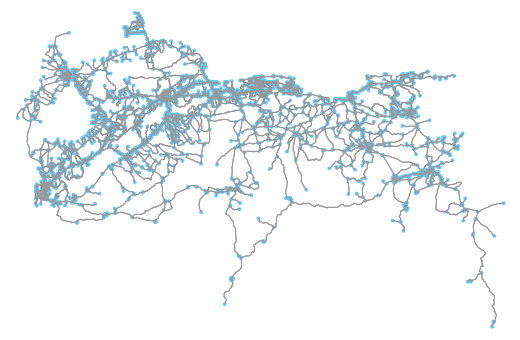

(<Figure size 677.686x432 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f395015f950>)

In [19]:
ox.plot_graph(G)

The graph is a data structure that represents the connections (egdes) between nodes (vertices). We are using the <i>Networkx MultiDiGraph</i> which is a directed graph that can store multiple edges between two nodes. Because edges are directed, then there can be a situation where there is a connection: A--->B, but not necessarily there will be a reverse connection (B--->A), this may happen for one-way roads.

For directed graphs we can distinguish the predecessors and the successors:
- A predecessor of <i>n</i> is a node <i>m</i> such that there exists a directed edge from <i>m</i> to <i>n</i>.
- A successor of <i>n</i> is a node <i>m</i> such that there exists a directed edge from <i>n</i> to <i>m</i>.

If a graph contains a node that doesn't have any connections from itself to other nodes, in other words, doesn't have any successors then we have to change this node to one of its predecessors.

In parts of the country where the road network is underdeveloped, we can encounter issues concerning the computation of the isoline. Namely, if we would like to obtain, for example, the 40 km isoline, while the longest road from our starting node in any direction is shorter than 40 km, then the <i>Networkx</i> library will fail to create the sub-graph for that isoline.

Next, we will project the graph to The Universal Transverse Mercator (UTM) system and fetch the Coordinate Reference System details.

In [20]:
G_projected = ox.project_graph(G)

G_projected_crs = ox.graph_to_gdfs(G_projected, nodes=False, edges=True).crs

Below we will define the function which utilizes the <i>Networkx</i> to compute isolines for the set of coordinates and distances. The function returns the dictionary of the following structure:<br>
{<br>
&ensp;&ensp;'level_0': {'geometry': [shapely.geometry]},<br>
&ensp;&ensp;'level_1': {'geometry': [shapely.geometry]},<br>
&ensp;&ensp;...<br>
&ensp;&ensp;'level_n-1': {'geometry': [shapely.geometry]}<br>
}<br>
Where levels consecutively correspond to the specific values from the list of isolines ranges, and n is the number of levels (isoline ranges).

We can adjust the <i>edge_buff</i> and <i>node_buff</i> parameters (distances in meters) to create the additional buffer increasing the isoline area around nodes and edges.

In [21]:
def OSMNX_isolines(coordinates, distances, edge_buff=2000, node_buff=2000, infill=True):
    """The function uses Networkx to compute the isolines for health facilities, that are specified
    by the coordinates parameter. The returned dictionary has the following structure:
    {'level_n': {'geometry': [shapely.geometry]}
    
    Parameters
    ----------
    coordinates: list
        List of tuples containing the latitude and longitude coordinates: [(lat, long)]
    distances: list
        List of isoline values (distances) in meters.
    edge_buff: int, optional (default=2000)
        The width of the edges buffer in meters.
    node_buff: int, optional (default=2000)
        The width of the nodes buffer in meters.
    infill: boolean, optional (default=True)
        Whether to fill the empty spaces inside the geometry.
    
    Returns
    -------
    isolines: dict 
        Dictionary of the health facilities isolines.
        
    """
    
    isolines = {}
    
    for i in tqdm(coordinates, desc='Creating isolines'):
        node = ox.get_nearest_node(G, (i[0], i[1]))

        # if the node doesn't have any successors, then change node to one of its predecessors
        if not list(G_projected.successors(node)):
            print("Change the node: ", node, end="")
            node = list(G_projected.predecessors(node))[0]
            print(" to: ", node, " due to lack of successors")
                
        for level, distance in enumerate(distances):

            subgraph = nx.ego_graph(G_projected, node, radius=distance, distance="length")
            
            # Skip subgraph if it contains only one node
            if len(list(subgraph.nodes())) <= 1:
                print('Subgraph (isoline) for distance: {} km and node: {} was skipped due to'\
                      ' not sufficient amount of adjacent nodes in a chosen range'\
                      .format(distance/1000, node))
                continue

            node_points = [Point((data['x'], data['y'])) for node, data in subgraph.nodes(data=True)]
            nodes_gdf = gpd.GeoDataFrame({'id': subgraph.nodes()}, geometry=node_points)
            nodes_gdf = nodes_gdf.set_index('id')

            edge_lines = []
            for n_fr, n_to in subgraph.edges():
                f = nodes_gdf.loc[n_fr].geometry
                t = nodes_gdf.loc[n_to].geometry
                edge_lines.append(LineString([f,t]))

            n = nodes_gdf.buffer(node_buff)
            n.crs = G_projected_crs
            n = n.to_crs(adm_boundaries.crs).geometry
            
            e = gpd.GeoSeries(edge_lines).buffer(edge_buff)
            e.crs = G_projected_crs
            e = e.to_crs(adm_boundaries.crs).geometry
            
            all_gs = list(n) + list(e)
            new_iso = gpd.GeoSeries(all_gs).unary_union

            # Fill in surrounded areas so shapes will appear solid
            if infill:
                new_iso = Polygon(new_iso.exterior)

            isolines.setdefault("level_{}".format(level), {'geometry': []})

            isolines['level_{}'.format(level)]['geometry'].append(new_iso)

    return isolines

Before we run the function we have to create the list of isoline distances. You have two options: specify the maximum range and interval of isolines or provide the list of distances manually.

In [22]:
iso_range = 0
iso_interval = 0

# OR specify a list of distances 

iso_distances = [40000, 80000, 120000]
n_levels = len(iso_distances)

In [23]:
if iso_range and iso_interval:
    n_levels = iso_range // iso_interval
    iso_distances = [iso_interval * n for n in range(1, n_levels + 1)]

Next, by using the following code, we will create the list of latitude and longitude pairs representing the health facilities.

In [24]:
coords = [(coord.y, coord.x) for coord in health_nodes.geometry]

Now, we can run the function to compute the isolines.

In [25]:
isolines = OSMNX_isolines(coords, iso_distances, edge_buff=2000, node_buff=2000, infill=True)

Creating isolines:  14%|█▎        | 23/168 [15:47<44:57, 18.60s/it]  

Subgraph (isoline) for distance: 40.0 km and node: 2518787651 was skipped due to not sufficient amount of adjacent nodes in a chosen range


Creating isolines:  31%|███       | 52/168 [38:30<52:00, 26.91s/it]  

Subgraph (isoline) for distance: 40.0 km and node: 1234484898 was skipped due to not sufficient amount of adjacent nodes in a chosen range


Creating isolines:  48%|████▊     | 81/168 [55:42<39:49, 27.47s/it]  

Change the node:  2811294192 to:  1342149781  due to lack of successors


Creating isolines:  52%|█████▏    | 87/168 [1:01:15<58:36, 43.41s/it]  

Subgraph (isoline) for distance: 40.0 km and node: 5256590738 was skipped due to not sufficient amount of adjacent nodes in a chosen range


Creating isolines:  66%|██████▌   | 111/168 [1:11:08<28:30, 30.02s/it]

Change the node:  6724924500 to:  6724924489  due to lack of successors


Creating isolines:  82%|████████▏ | 138/168 [1:18:39<06:26, 12.88s/it]

Subgraph (isoline) for distance: 40.0 km and node: 3847262265 was skipped due to not sufficient amount of adjacent nodes in a chosen range
Subgraph (isoline) for distance: 80.0 km and node: 3847262265 was skipped due to not sufficient amount of adjacent nodes in a chosen range
Subgraph (isoline) for distance: 120.0 km and node: 3847262265 was skipped due to not sufficient amount of adjacent nodes in a chosen range


Creating isolines:  93%|█████████▎| 156/168 [1:24:35<01:53,  9.48s/it]

Subgraph (isoline) for distance: 40.0 km and node: 818230557 was skipped due to not sufficient amount of adjacent nodes in a chosen range


Creating isolines:  96%|█████████▋| 162/168 [1:25:11<00:49,  8.33s/it]

Subgraph (isoline) for distance: 40.0 km and node: 1157810918 was skipped due to not sufficient amount of adjacent nodes in a chosen range
Subgraph (isoline) for distance: 80.0 km and node: 1157810918 was skipped due to not sufficient amount of adjacent nodes in a chosen range


Creating isolines: 100%|██████████| 168/168 [1:26:18<00:00, 30.82s/it]


#### Intersections between isolines and districts

In order to properly perform the union operation of the isolines we have to ensure that all isolines objects are valid, if some of them are not, then we will fix them with .buffer(0) method.

In [26]:
for level in range(n_levels):
    for i in range(len(isolines['level_{}'.format(level)]['geometry'])):
        tmp_isoline = isolines['level_{}'.format(level)]['geometry'][i]
        if tmp_isoline.is_valid:
            continue
        else:
            isolines['level_{}'.format(level)]['geometry'][i] = tmp_isoline.buffer(0)

Now that we know that all isolines are valid, we can safely perform the unary union of all isolines at a specific level.

In [27]:
level_values = iso_distances
isolines_level_unions = []

for level in range(n_levels):
    isolines_level_unions.append(unary_union(isolines['level_{}'.format(level)]['geometry']))

Below we will create and save the shapefile of the intersections between isolines and districts.

In [28]:
schema = {'geometry': 'Polygon',
          'properties': {'dist_id': 'str', 'level': 'int'}}

isolines_per_district_shp_file = '{0}/{0}-isoline_per_district_OSMNX.shp'.format(country_list.value)

isolines_per_dist = {}

for idx, row in adm_boundaries.iterrows():
    district_id = row['GID_2']
    district_geom = shape(row['geometry'])
    for level, iso_level in enumerate(isolines_level_unions):
        for poly in iso_level:
            if district_geom.intersects(poly):
                properties = {'dist_id': district_id,
                              'level': level}
                iso_dist_intersection = district_geom.intersection(poly)
                if (district_id, level) not in isolines_per_dist.keys():
                    iso_dist_intersection = mapping(iso_dist_intersection)
                    isolines_per_dist[(district_id, level)] = {'geometry': iso_dist_intersection,
                                                               'properties': properties}
                else:
                    isoline_shape = shape(isolines_per_dist[(district_id, level)]['geometry'])
                    new_isoline_shape = isoline_shape.union(iso_dist_intersection)
                    isolines_per_dist[(district_id, level)]['geometry'] = mapping(new_isoline_shape)
                    

with fn.open(isolines_per_district_shp_file, 'w', driver='ESRI Shapefile', schema=schema) as output:
    for isoline in isolines_per_dist.values():
        output.write(isoline)


In [29]:
iso_per_dist = gpd.read_file(isolines_per_district_shp_file)

#### Total population in each district 

In this section, we are going to calculate the total population in each district (subnational entity). Subsequently, this information will be used to compute the proportion of the population that falls within specific health access isoline.

In [30]:
population_raster_file_path = '{0}/Population/{0}-reprj-population.tif'.format(country_list.value)

stats = zonal_stats(adm_bound_file_path, population_raster_file_path, stats=['sum'], geojson_out=True)

country_total_population = 0

# Create empty column to populate with district population data
if 'dist_pop' not in adm_boundaries.columns:
    adm_boundaries = adm_boundaries.assign(dist_pop=np.NaN)

for dist_stat in stats:
    dist_id = dist_stat['properties']['GID_2']
    dist_pop = dist_stat['properties']['sum']
    country_total_population += dist_pop
    
    adm_boundaries.loc[adm_boundaries.GID_2 == dist_id, ['dist_pop']] = dist_pop 
    
print('{} total population: {}'.format(country_list.value, int(country_total_population)))

Venezuela total population: 28482798


#### Population within given isoline

Now we will calculate the population that resides the area corresponding to the intersection between particular district and isoline.

In [31]:
stats = zonal_stats(isolines_per_district_shp_file, population_raster_file_path, stats=['sum'], geojson_out=True)

if 'iso_dist_pop' not in iso_per_dist.columns:
    iso_per_dist = iso_per_dist.assign(iso_dist_pop=np.NaN)

iso_per_dist.set_index(['dist_id', 'level'], inplace=True)

for dist_stat in stats:
    dist_id = dist_stat['properties']['dist_id']
    level = dist_stat['properties']['level']
    dist_pop = dist_stat['properties']['sum']
    
    iso_per_dist.loc[(dist_id, level), ['iso_dist_pop']] = dist_pop
    
iso_per_dist.reset_index(inplace=True)

#### Distribution of the population with health access in a district

Below we will calculate the proportion of the population in a district that has a certain health care access.

In [32]:
for level in range(n_levels):
    if 'pop_level_{}'.format(level) not in adm_boundaries.columns:
        adm_boundaries['pop_level_{}'.format(level)] = np.NaN
    if 'pct_pop_level_{}'.format(level) not in adm_boundaries.columns:
        adm_boundaries['pct_pop_level_{}'.format(level)] = np.NaN

iso_per_dist.set_index(['dist_id', 'level'], inplace=True)

for idx, row in adm_boundaries.iterrows():
    dist_id = row.GID_2
    total_dist_pop = row.dist_pop
    for level in range(n_levels):
        if iso_per_dist.index.isin([(dist_id, level)]).any():
            iso_dist_pop = float(iso_per_dist.loc[(dist_id, level), ['iso_dist_pop']])
            adm_boundaries.loc[adm_boundaries.GID_2 == dist_id, ['pop_level_{}'.format(level)]] = iso_dist_pop
            pct_pop = 100 * iso_dist_pop / (total_dist_pop + 0.01)
            adm_boundaries.loc[adm_boundaries.GID_2 == dist_id, ['pct_pop_level_{}'.format(level)]] = pct_pop
        else:
            adm_boundaries.loc[adm_boundaries.GID_2 == dist_id, ['pop_level_{}'.format(level)]] = np.NaN
            adm_boundaries.loc[adm_boundaries.GID_2 == dist_id, ['pct_pop_level_{}'.format(level)]] = np.NaN
        
iso_per_dist.reset_index(inplace=True)

#### The map of isolines

In this section, we will create a map of health care access isolines. As usual, we will begin by checking the Coordinate Reference System compatibility.

In [33]:
print("CRS coherent: ", adm_boundaries.crs == health_nodes.crs)

CRS coherent:  True


Now we will define the starting localization and initialize the map.

In [34]:
minx, miny, maxx, maxy = adm_boundaries.total_bounds
start_coord = [(miny + maxy)/2, (minx + maxx)/2]

isolines_map = folium.Map(tiles="openstreetmap", location=start_coord, zoom_start=6)

In [35]:
use_health_fac_html_popup = True
popups, locations = [], []

# If you would like to display all health facilities then use the all_health_nodes data frame in the following loop
for idx, row in health_nodes.iterrows():
    locations.append([row['geometry'].y, row['geometry'].x])
    address = row["addr_street"].encode('ascii', 'xmlcharrefreplace').decode() if row["addr_street"] else ""
    amenity = row["amenity"].encode('ascii', 'xmlcharrefreplace').decode() if row["amenity"] else ""
    name = row["name"].encode('ascii', 'xmlcharrefreplace').decode() if row["name"] else ""
    
    if use_health_fac_html_popup:
        popup = folium.Popup(health_fac_popup_table_html(name, amenity, address), max_width=320, max_height=140)
    else:
        popup_mmsg = ("Name: {}<br>Amenity: {}<br>Address: {}<br>".format(name, amenity, address).strip(","))
        popup = folium.Popup(popup_mmsg, max_width=140, max_height=100)
        
    popups.append(popup)

hf = folium.FeatureGroup(name='Health facilities')
hf.add_child(MarkerCluster(locations=locations, popups=popups))
isolines_map.add_child(hf)

iso_colors = ['#f2f205', '#f7a202', '#fc4300']

def iso_style_fc(feature):
    level = (feature['geometry']['level'])
    color = iso_colors[level]
    return {'weight':2,
            'fillColor': color,
            'color': color}

# Reverse isoline levels order
isolines_level_unions.reverse()

for idx, iso_level in enumerate(isolines_level_unions, 1):
    # Add isoline level layer
    level_mapping = mapping(iso_level)
    level_mapping['level'] = -idx + len(isolines_level_unions)
    level_layer = folium.GeoJson(level_mapping, name="< {} km isoline".format(level_values[-idx]//1000),
                        style_function=iso_style_fc)
    isolines_map.add_child(level_layer)

# Reverse the order of levels back
isolines_level_unions.reverse()
    
district_simp = []

boundaries = FeatureGroup(name='Administrative boundaries')

for idx, row in adm_boundaries.iterrows():
    name = row['NAME_2'].encode('ascii', 'xmlcharrefreplace').decode()
    geom = shape(row['geometry'])
    simp_geom = geom.simplify(0.005, preserve_topology=False)
    simp_coord = mapping(simp_geom)    
    adm_bound_layer = folium.GeoJson(simp_coord,
                               highlight_function=lambda x: {'weight':3, 'fillColor':'#00FFFFFF'},
                               style_function=lambda feature: {'weight':1,
                                                               'fillColor': '#00000000',
                                                               'color': 'blue'},
                               tooltip=name)
    
    popup_data = []
    for level in range(n_levels):
        pct_pop = round(row['pct_pop_level_{}'.format(level)], 2)
        tot_pop = row['pop_level_{}'.format(level)]
        if not pd.isna(tot_pop):
            tot_pop = int(row['pop_level_{}'.format(level)])
        range_km = '< {} km'.format(int(level_values[level] / 1000))
        popup_data.append([range_km, (tot_pop, pct_pop)])
    
    population_table = generate_population_table(popup_data)
    folium.Popup(population_table,  max_width=280, max_height=140).add_to(adm_bound_layer)
    adm_bound_layer.add_to(boundaries)
    district_simp.append(simp_coord)
    
boundaries.add_to(isolines_map)

folium.TileLayer('cartodbdark_matter', overlay=False, show=False, name="dark mode").add_to(isolines_map)

folium.LayerControl(collapsed=True).add_to(isolines_map)

In [36]:
isolines_map

In [34]:
isolines_map.save("{}_isolines_map_OSMNX.html".format(country_list.value))

#### The choropleth map

In this section we will create the choropleth map of the population with health care access.

In [35]:
minx, miny, maxx, maxy = adm_boundaries.total_bounds
start_coord = [(miny + maxy)/2, (minx + maxx)/2]

choropleth_map = folium.Map(tiles=None, location=start_coord, zoom_start=6, overlay=False)

In [36]:
features_groups = []
for level in level_values:
    range_km = '< {} km isoline'.format(int(level / 1000))
    fg = folium.FeatureGroup(name=range_km, overlay=False).add_to(choropleth_map)
    features_groups.append(fg)

geo_data = json.loads(adm_boundaries.loc[:, ['GID_2', 'NAME_2', 'geometry']].to_json())

# Simplify the geometry for displaying purposes
for data in geo_data['features']:
    geom = shape(data['geometry'])
    simp_geom = geom.simplify(0.005, preserve_topology=False)
    simp_coord = mapping(simp_geom) 
    data['geometry'] = simp_coord

for level in range(n_levels):
    choropleth = folium.Choropleth(
        geo_data=geo_data,
        key_on='feature.properties.GID_2',
        data=adm_boundaries,
        columns=['GID_2', 'pct_pop_level_{}'.format(level)],
        name='choropleth',
        fill_color='YlGn',
        nan_fill_color="white",
        fill_opacity=0.7,
        line_opacity=0.2,
        highlight=True,
        line_color='black').geojson.add_to(features_groups[level])
    
    folium.GeoJson(geo_data,
                   highlight_function=lambda x: {'weight':3, 'fillColor':'grey'},
                   style_function=lambda x: {'weight':0.5, 'color':'black', 'fillColor':'transparent'},
                   tooltip=folium.GeoJsonTooltip(fields=['NAME_2'],
                                                 labels=False,
                                                 sticky=True)).add_to(choropleth)

scale = linear.YlGn_09.scale(0, 100).to_step(10)
scale.caption = '% of population in district within isoline'
scale.add_to(choropleth_map)

folium.TileLayer('openstreetmap', overlay=True, show=True, name="map").add_to(choropleth_map)    

folium.LayerControl(collapsed=False).add_to(choropleth_map)

In [37]:
choropleth_map

In [38]:
choropleth_map.save("{0}/{0}_choropleth_map_OSMNX.html".format(country_list.value))